## Load Dependencies

In [1]:
import sys

!conda install --yes --quiet --prefix {sys.prefix} missingno altair plotly
!{sys.executable} -m pip install missingpy --quiet

Solving environment: ...working... done

# All requested packages already installed.



## Load Data Frames

In [2]:
import pandas as pd
import numpy as np

predom_variant_dict = {
    'unknown':('2020-01-21', '2020-12-31'),
    'epsilon':('2021-01-01', '2021-02-28'),
    'alpha-iota-gamma':('2021-03-01', '2021-06-13'),
    'delta':('2021-06-14', '2021-12-12'),
    'omicron':('2021-12-13', '2022-04-07'),
}

def get_predom_variant_series():    
    result = None
    
    for predom_variant in predom_variant_dict:
        date_start, date_end = predom_variant_dict[predom_variant]
        date_ix = pd.date_range(date_start, date_end)
        new_series = pd.Series([predom_variant for _ in date_ix], date_ix, name='predominant_variant')
        
        if result is None:
            result = new_series
        else:
            result = pd.concat([result, new_series])
        
    return result

def get_df_cases():
    result_df = (pd.read_csv('NYT COVID-19/covid-19-cases-deaths-us-counties.csv', parse_dates=['date'])
                .rename({'deaths':'deaths_cum', 'cases':'cases_cum', }, axis=1))
    # Fill in fips code for NY City
    ix = result_df[(result_df['state'] == 'New York') & (result_df['county'] == 'New York City')].index
    result_df.loc[ix, 'fips'] = 36061
    result_df.loc[ix, 'county'] = 'New York'
    # Aggregate Kansas City into Jackson County and Joplin City into Jasper County
    for state, old_county, new_county, fips in [('Missouri', 'Kansas City', 'Jackson', 29095),
                                                ('Missouri', 'Joplin', 'Jasper', 29097)]:
        ix = result_df[(result_df['state'] == state) & (result_df['county'] == old_county)].index
        result_df.loc[ix, 'fips'] = fips
        result_df.loc[ix, 'county'] = new_county
        append_df = (result_df[(result_df['state'] == state) & (result_df['county'] == new_county)]
               .groupby(['date', 'county', 'state', 'fips'])
               .sum()
               .reset_index())
        ix = result_df[(result_df['state'] == state) & (result_df['county'] == new_county)].index
        result_df.drop(ix, inplace=True)
        result_df = result_df.append(append_df, ignore_index=True)
    
    return result_df.merge(get_predom_variant_series(), left_on='date', right_index=True).reset_index(drop=True)

df_cases = get_df_cases()
df_census = pd.read_csv('Census Data/Census_ACS_county2016_2020.csv', index_col='county')

Now that our data is loaded, lets check the shape

In [3]:
print('NY Times COVID-19 shape: ', df_cases.shape, 'Census ACS shape: ', df_census.shape)

NY Times COVID-19 shape:  (2384204, 7) Census ACS shape:  (3221, 62)


Lets check the columns and data types

In [4]:
df_cases.dtypes

date                   datetime64[ns]
county                         object
state                          object
fips                          float64
cases_cum                       int64
deaths_cum                    float64
predominant_variant            object
dtype: object

In [5]:
df_census.dtypes[:20]

totpop                int64
medhhincome         float64
medhvalue           float64
popdens             float64
male                float64
age_under18         float64
age_18_24           float64
age_25_44           float64
age_45_64           float64
age_65pl            float64
race_white          float64
race_black          float64
race_native         float64
race_asian          float64
race_hawaiian       float64
race_otherOrmore    float64
married             float64
educ_lesshs         float64
educ_somecoll       float64
educ_college        float64
dtype: object

In [6]:
df_census.dtypes[20:40]

educ_collpl         float64
urate_all           float64
urate_male          float64
urate_female        float64
ind_agmining        float64
ind_const           float64
ind_manuf           float64
ind_wholesale       float64
ind_retail          float64
ind_transport       float64
ind_info            float64
ind_FIRE            float64
ind_pro             float64
ind_educhealth      float64
ind_artentertain    float64
ind_otherserve      float64
ind_public          float64
occ_mgmtbiz         float64
occ_pro             float64
occ_healthsupp      float64
dtype: object

In [7]:
df_census.dtypes[40:]

occ_protective      float64
occ_food            float64
occ_building        float64
occ_personalcare    float64
occ_sales           float64
occ_officeadmin     float64
occ_farming         float64
occ_constextract    float64
occ_production      float64
occ_transport       float64
income_less10k      float64
income_10k24k       float64
income_25k34k       float64
income_35k44k       float64
income_45k59k       float64
income_60k99k       float64
income_100k149k     float64
income_over150k     float64
poverty_white       float64
poverty_black       float64
vetshare_18_64      float64
vetshare_65pl       float64
dtype: object

Lets check out the head and tail of our data frames to ensure the meta data aligns with the values we observe

In [8]:
df_census.head()
# df_census.tail()

,totpop,medhhincome,medhvalue,popdens,male,age_under18,age_18_24,age_25_44,age_45_64,age_65pl,...,income_25k34k,income_35k44k,income_45k59k,income_60k99k,income_100k149k,income_over150k,poverty_white,poverty_black,vetshare_18_64,vetshare_65pl
county,,,,,,,,,,,,,,,,,,,,,
1001,55639,57982.0,161200.0,93.596481,0.486206,0.236219,0.083323,0.258488,0.269379,0.152591,...,0.085347,0.091145,0.102370,0.237070,0.164015,0.089290,0.114252,0.298559,0.059708,0.049393
1003,218289,61756.0,211600.0,137.302840,0.485086,0.215279,0.072074,0.232710,0.275089,0.204848,...,0.099766,0.096410,0.116637,0.232084,0.154628,0.124395,0.078613,0.177771,0.049545,0.062600
1005,25026,34990.0,86500.0,28.277708,0.525693,0.208663,0.080197,0.267322,0.252937,0.190881,...,0.094079,0.094615,0.104913,0.161339,0.091075,0.047951,0.149815,0.394427,0.027722,0.039941
1007,22374,51721.0,96400.0,35.943928,0.537320,0.204881,0.080585,0.283052,0.267185,0.164298,...,0.090922,0.074253,0.124673,0.262708,0.111861,0.049731,0.138433,0.354746,0.036931,0.030804
1009,57755,48922.0,135300.0,89.557816,0.496528,0.231530,0.079110,0.241347,0.268254,0.179759,...,0.112332,0.098232,0.131148,0.201792,0.124075,0.076114,0.137078,0.129464,0.039153,0.037709


In [9]:
df_cases.head()
# df_cases.tail()

,date,county,state,fips,cases_cum,deaths_cum,predominant_variant
0,2020-01-21,Snohomish,Washington,53061.0,1,0.0,unknown
1,2020-01-22,Snohomish,Washington,53061.0,1,0.0,unknown
2,2020-01-23,Snohomish,Washington,53061.0,1,0.0,unknown
3,2020-01-24,Cook,Illinois,17031.0,1,0.0,unknown
4,2020-01-24,Snohomish,Washington,53061.0,1,0.0,unknown


## Investigate Missing/incorrect data

### NY-Times COVID-19

In [10]:
def get_df_cases_missing_summary():
    result_df = df_cases.isnull().sum() 
    result_df = result_df[result_df > 0].rename('count').to_frame()
    result_df['percent'] = result_df['count'] / len(df_cases)
    return result_df

get_df_cases_missing_summary()

,count,percent
fips,20169,0.008459
deaths_cum,54797,0.022983


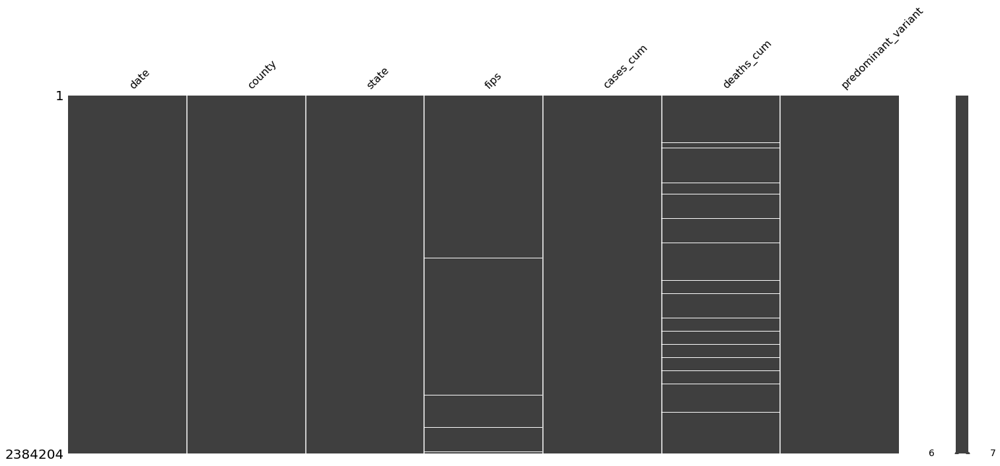

In [65]:
import missingno as msno
import matplotlib.pyplot as plt

msno.matrix(df_cases)
plt.savefig('msno-matrix-nyt', dpi=300)

Lets discover what the min and max dates reported are

In [12]:
print('min date:', df_cases['date'].min(), 'max date:', df_cases['date'].max())

min date: 2020-01-21 00:00:00 max date: 2022-04-07 00:00:00


I notice that some FIPS codes are missing, our group made every effort to salvage counties by co-locating missing codes but we were unable to salvage all of them. Lets see how many cases and deaths this impacts.

In [13]:
df_cases[df_cases.fips.isnull()].groupby(['state', 'county']).max().sum()[1:]

/opt/anaconda3/envs/593/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  """Entry point for launching an IPython kernel.


cases_cum                                                        1261159
deaths_cum                                                       24347.0
predominant_variant    unknownomicronunknownunknownunknownunknownunkn...
dtype: object

For rows that are missing reported deaths, we assume that they either did not have any to report at that time or that the NY Times was unable to collect the information. What we are most interested in is to see which counties haven't reported any deaths for the duration of the Pandemic. These we will consider dropping from our analysis.

In [14]:
def print_non_reporting_counties():
    result = df_cases.groupby(['state', 'county']).max()
    result = result[result['deaths_cum'].isnull()].reset_index()[['state', 'county']]
    print('States that are missing reported deaths:', result['state'].unique().tolist())
    print('Counties that are missing reported deaths:', result['county'].unique().tolist())
    
print_non_reporting_counties()

States that are missing reported deaths: ['Puerto Rico']
Counties that are missing reported deaths: ['Adjuntas', 'Aguada', 'Aguadilla', 'Aguas Buenas', 'Aibonito', 'Anasco', 'Arecibo', 'Arroyo', 'Barceloneta', 'Barranquitas', 'Bayamon', 'Cabo Rojo', 'Caguas', 'Camuy', 'Canovanas', 'Carolina', 'Catano', 'Cayey', 'Ceiba', 'Ciales', 'Cidra', 'Coamo', 'Comerio', 'Corozal', 'Culebra', 'Dorado', 'Fajardo', 'Florida', 'Guanica', 'Guayama', 'Guayanilla', 'Guaynabo', 'Gurabo', 'Hatillo', 'Hormigueros', 'Humacao', 'Isabela', 'Jayuya', 'Juana Diaz', 'Juncos', 'Lajas', 'Lares', 'Las Marias', 'Las Piedras', 'Loiza', 'Luquillo', 'Manati', 'Maricao', 'Maunabo', 'Mayaguez', 'Moca', 'Morovis', 'Naguabo', 'Naranjito', 'Orocovis', 'Patillas', 'Penuelas', 'Ponce', 'Quebradillas', 'Rincon', 'Rio Grande', 'Sabana Grande', 'Salinas', 'San German', 'San Juan', 'San Lorenzo', 'San Sebastian', 'Santa Isabel', 'Toa Alta', 'Toa Baja', 'Trujillo Alto', 'Utuado', 'Vega Alta', 'Vega Baja', 'Vieques', 'Villalba', 'Ya

Unfortunately we won't be able to salvage these counties in Puerto Rico.

### Census ACS

In [15]:
def get_df_census_missing_summary():
    result_df = df_cases.isnull().sum() 
    result_df = result_df[result_df > 0].rename('count').to_frame()
    result_df['percent'] = result_df['count'] / len(df_census)
    return result_df

get_df_census_missing_summary()

,count,percent
fips,20169,6.261720
deaths_cum,54797,17.012419


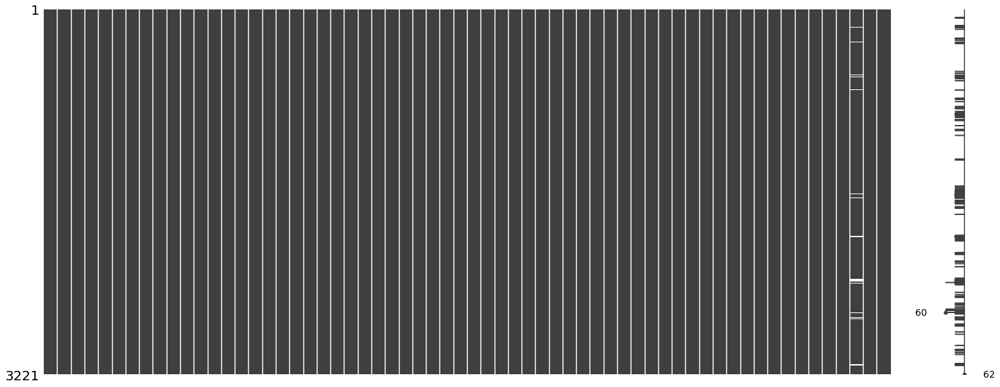

In [64]:
import missingno as msno
import matplotlib.pyplot as plt

msno.matrix(df_census)
plt.savefig('msno-matrix-census', dpi=300)

We are missing 5% of the values for the black poverty rate, lets see what counties this affects. Fortunately all of these counties are in our NY Times dataset and we can use that to discover the names and states of these counties.

In [17]:
def print_non_reporting_counties():
    result = df_cases[['fips', 'county', 'state']].groupby(['fips', 'county', 'state']).count().reset_index()
    result['fips'] = result['fips'].astype(np.int64)
    missing_ix =  df_census[df_census['poverty_black'].isnull()].index
    result = result[result['fips'].isin(missing_ix)]
    print('Counties that are missing black poverty:', result[['state','county']].to_numpy())

    
print_non_reporting_counties()

Counties that are missing black poverty: [['Alaska' 'Haines Borough']
 ['Arkansas' 'Izard']
 ['Arkansas' 'Madison']
 ['Arkansas' 'Newton']
 ['Arkansas' 'Searcy']
 ['Colorado' 'Cheyenne']
 ['Colorado' 'Dolores']
 ['Colorado' 'Kiowa']
 ['Colorado' 'Phillips']
 ['Colorado' 'San Juan']
 ['Colorado' 'San Miguel']
 ['Idaho' 'Camas']
 ['Idaho' 'Caribou']
 ['Idaho' 'Lemhi']
 ['Idaho' 'Lincoln']
 ['Idaho' 'Teton']
 ['Illinois' 'Brown']
 ['Illinois' 'Calhoun']
 ['Illinois' 'Cumberland']
 ['Illinois' 'Henderson']
 ['Indiana' 'Decatur']
 ['Indiana' 'Washington']
 ['Iowa' 'Audubon']
 ['Iowa' 'Davis']
 ['Iowa' 'Monroe']
 ['Iowa' 'Ringgold']
 ['Iowa' 'Taylor']
 ['Kansas' 'Cheyenne']
 ['Kansas' 'Elk']
 ['Kansas' 'Grant']
 ['Kansas' 'Greeley']
 ['Kansas' 'Harper']
 ['Kansas' 'Haskell']
 ['Kansas' 'Hodgeman']
 ['Kansas' 'Lane']
 ['Kansas' 'Logan']
 ['Kansas' 'Morton']
 ['Kansas' 'Rush']
 ['Kansas' 'Scott']
 ['Kansas' 'Stafford']
 ['Kansas' 'Stanton']
 ['Kentucky' 'Elliott']
 ['Kentucky' 'Leslie']
 ['Ken

In [18]:
def get_non_reporting_counties_counts():
    result = df_cases[['fips', 'county', 'state']].groupby(['fips', 'county', 'state']).count().reset_index()
    result['fips'] = result['fips'].astype(np.int64)
    missing_ix =  df_census[df_census['poverty_black'].isnull()].index
    result = result[result['fips'].isin(missing_ix)]
    return result.groupby('state').count()

    
get_non_reporting_counties_counts()

,fips,county
state,,
Alaska,1,1
Arkansas,4,4
Colorado,6,6
Idaho,5,5
Illinois,4,4
Indiana,2,2
Iowa,5,5
Kansas,14,14
Kentucky,4,4


The number of counties missing these data and where they are located seems to suggest that these values are missing at random. Some of them could genuinely not have any black poverty however, that does not seem likely. Our group will attempt to impute these values for our regression and PCA anlaysis.

### The last thing we want to investigate is couties that are missing from the from our Census data that are in our NYT data and vice-versa.

Here are the County FIPS codes that are in the NY Times COVID 19 dataset but not in the Census ACS dataset. Unfortunately we are unable to include these counties in our analysis because we lack census characteristics, we will have to drop these from our analysis.

In [19]:
(df_cases[df_cases.fips.isin(set(df_cases.fips.unique().tolist()) - set(df_census.index))]
    .groupby(['fips', 'state', 'county'])
    .max()[['cases_cum', 'deaths_cum']])

,,,cases_cum,deaths_cum
fips,state,county,,
2261.0,Alaska,Valdez-Cordova Census Area,2895,17.0
2997.0,Alaska,Bristol Bay plus Lake and Peninsula,833,1.0
2998.0,Alaska,Yakutat plus Hoonah-Angoon,526,5.0
48999.0,Texas,Pending County Assignment,65,0.0
69100.0,Northern Mariana Islands,Rota,415,0.0
69110.0,Northern Mariana Islands,Saipan,10397,33.0
69120.0,Northern Mariana Islands,Tinian,341,0.0
78010.0,Virgin Islands,St. Croix,7751,47.0
78020.0,Virgin Islands,St. John,783,5.0


Here are the County FIPS codes that are in the Census ACS dataset but not in the NY Times COVID 19 dataset. A list of FIPS codes can be found here: https://www.nrcs.usda.gov/wps/portal/nrcs/detail/national/home/?cid=nrcs143_013697. These counties are located in Alaska and New York. It is very unfortunate that we must omit these from our analysis. Our group decided to look at the level of effort vs impact of salvaging these observations and made our decision.

In [20]:
df_census[df_census.index.isin(set(df_census.index.tolist()) - 
                               set(df_cases.fips.dropna().astype(int).unique().tolist()))]

,totpop,medhhincome,medhvalue,popdens,male,age_under18,age_18_24,age_25_44,age_45_64,age_65pl,...,income_25k34k,income_35k44k,income_45k59k,income_60k99k,income_100k149k,income_over150k,poverty_white,poverty_black,vetshare_18_64,vetshare_65pl
county,,,,,,,,,,,,,,,,,,,,,
2060,739,79808.0,222200.0,1.533267,0.560216,0.193505,0.047361,0.263870,0.378890,0.116373,...,0.059859,0.066901,0.133803,0.242958,0.225352,0.165493,0.026738,NaN,0.094340,0.030875
2063,6495,90776.0,234300.0,0.681544,0.550115,0.213549,0.064973,0.290993,0.296228,0.134257,...,0.090476,0.087879,0.125108,0.251082,0.211255,0.170563,0.042739,0.000000,0.113365,0.034606
2066,2894,64745.0,234500.0,0.117203,0.474775,0.278162,0.072218,0.237042,0.289565,0.123013,...,0.058325,0.024459,0.158043,0.205080,0.220132,0.136406,0.063069,0.000000,0.061234,0.061716
2105,2135,59926.0,221600.0,0.325693,0.538173,0.129742,0.053396,0.211241,0.379391,0.226230,...,0.055629,0.117881,0.111258,0.242384,0.129801,0.127152,0.061185,0.000000,0.060884,0.065194
2164,1156,48750.0,120500.0,0.048507,0.458477,0.256055,0.122837,0.288927,0.226644,0.105536,...,0.114754,0.109290,0.103825,0.262295,0.095628,0.062842,0.054545,0.000000,0.034884,0.030233
2282,597,59517.0,171200.0,0.078313,0.592965,0.227806,0.055276,0.333333,0.242881,0.140704,...,0.054299,0.049774,0.330317,0.235294,0.162896,0.063348,0.100000,0.000000,0.019523,0.065076
36005,1427056,41895.0,427900.0,33839.059000,0.471239,0.248540,0.099639,0.285730,0.237044,0.129047,...,0.095698,0.088653,0.109783,0.185386,0.107095,0.073057,0.228575,0.261133,0.012069,0.009834
36047,2576771,63973.0,734800.0,37141.805000,0.473864,0.228302,0.080708,0.322672,0.228314,0.140004,...,0.078446,0.071163,0.092127,0.192860,0.143916,0.186557,0.173610,0.196084,0.008903,0.009250
36081,2270976,72028.0,575600.0,20887.518000,0.485335,0.201361,0.076365,0.297878,0.266079,0.158317,...,0.078259,0.073266,0.102600,0.227980,0.175132,0.174214,0.098762,0.105277,0.010497,0.011861


In [21]:
df_cases[df_cases.fips == 36005.0]

,date,county,state,fips,cases_cum,deaths_cum,predominant_variant


# Geomap and Correlation

This section will focus on pre-processing our datasets to create a geographical map of the US by deaths per population (1:1000). We will also start exploring possible correlations of interest. 

### Pre-processing

In [22]:
def get_df_reg():
    # We'll asume that missing values for death counts are inicative of 
    # no observed deaths for that county except for Puerto Rico.
    mask = ~(df_cases['fips'].isnull()) & (df_cases['state'] != 'Puerto Rico')
    result_df = df_cases[mask].sort_values(['fips', 'date'])
    
    result_df['fips'] = result_df['fips'].astype(np.int64)

    result_df = (result_df[['fips', 'county', 'state', 'cases_cum', 'deaths_cum']]
                 .groupby(['fips', 'county', 'state'])
                 .max()
                 .rename({'cases_cum':'cases', 'deaths_cum':'deaths'}, axis=1)
                 .reset_index(level=[1, 2])
                 .merge(df_census, how='inner', left_index=True, right_index=True))

    result_df['cases_per_1000'] = result_df['cases']/(result_df['totpop']/1000)
    result_df['deaths_per_1000'] = result_df['deaths']/(result_df['totpop']/1000)
    
    return result_df

reg_df = get_df_reg()

In [23]:
#import tools needed 
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)
#setting fips codes for processing 
df = reg_df.reset_index()
df['fips'] = df['index']

#function changes datatype / format of fips codes used for geo location
def fix_fips(df=df):
    df['fips'] = df['fips'].astype(int)
    df['fips'] = df['fips'].astype(str)
    df.loc[df["fips"].str.len() == 4 , "fips"] = '0' + df["fips"]
    return df

df = fix_fips(df)

In [24]:
#check number of non-death reporting counties 
len(df[df['deaths']==0])
#split useable and non usable data for mapping 
covid_cases, non_reporting_counties = df[df['deaths']!=0], df[df['deaths']==0]

In [25]:
#double proofing for mapping purposes 
geoDict = {}
for i in counties['features']:
    geoDict[i['properties']['NAME']] = i['id']
    
missing_GeoID = [] 

def map_fips(x):
    if x in geoDict:
        return geoDict[x]
    else:
        missing_GeoID.append(x)
        return covid_cases.loc[covid_cases['county'] == str(x)]['fips'].values[0]
    
covid_cases['GeoID'] = covid_cases['county'].apply(lambda x: map_fips(x))

/opt/anaconda3/envs/593/lib/python3.7/site-packages/ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  from ipykernel import kernelapp as app


In [26]:
#testing geomapper as a backup for counties
geoDict['Bronx']

'36005'

### Dataset Results and Overview 

In [27]:
print("Number of counties to be mapped:",len(covid_cases.fips.unique()))
print("Number of non-reporting counties:",len(non_reporting_counties.fips.unique()))
covid_cases = covid_cases.drop(['index','GeoID'],axis=1)

Number of counties to be mapped: 3119
Number of non-reporting counties: 14


### Correlation Overview 

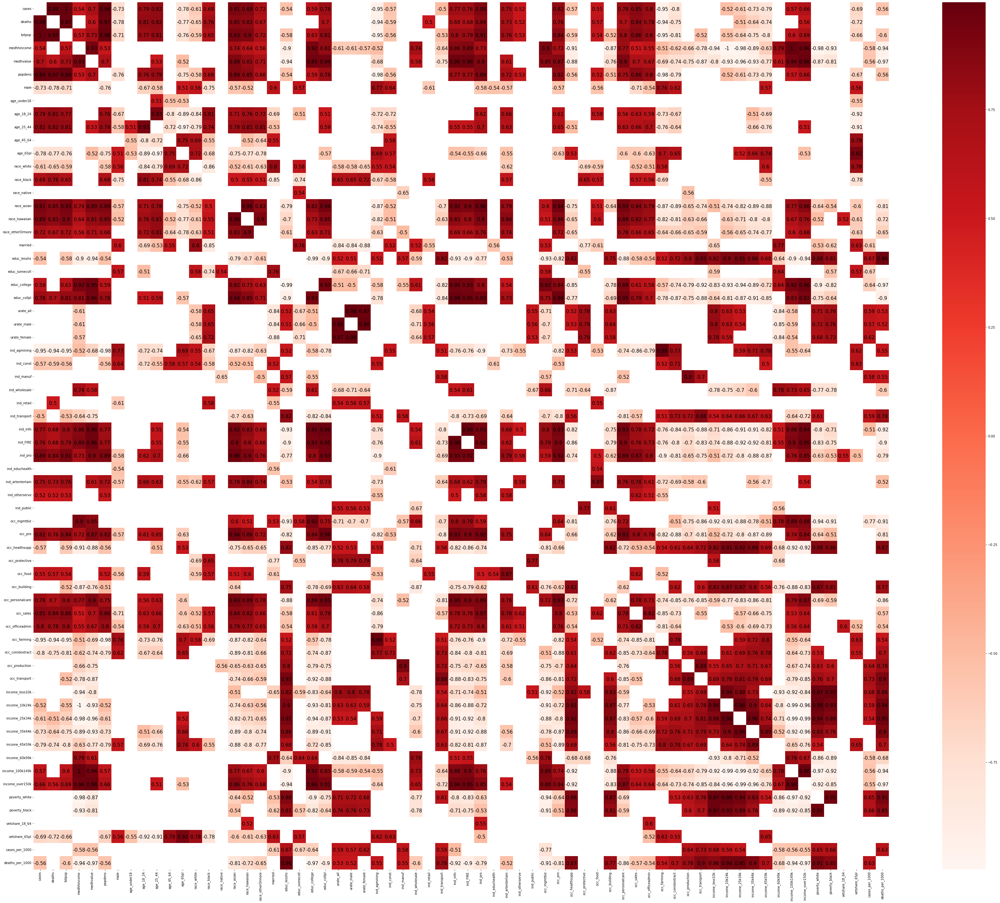

In [28]:
import pandas as pd 
import seaborn as sn
from matplotlib import pyplot as plt

def corrMap(df):
    
    dfCorr = df.corr().drop_duplicates()
    
    filteredDf = dfCorr[((dfCorr >= .5) | (dfCorr <= -.5)) & (dfCorr !=1.000)]
    plt.figure(figsize=(60,50))
    plt.rcParams['axes.facecolor'] = 'white'
    sn.heatmap(filteredDf, annot=True,
               annot_kws={"size": 15, "va": "center_baseline", "color": "black"},
               cmap="Reds")
    plt.show()
    
def corrFilter(x: pd.DataFrame, bound: float,method='kendall'):
    xCorr = x.corr(method)
    xFiltered = xCorr[((xCorr >= bound) | (xCorr <= -bound)) & (xCorr !=1.000)]
    return xFiltered

def corrFilterFlattened(x: pd.DataFrame, bound: float):
    xFiltered = corrFilter(x, bound)
    xFlattened = xFiltered.unstack().sort_values().drop_duplicates()
    return xFlattened

def filterForLabels(df: pd.DataFrame, label):  
    try:
        sideLeft = df[label,]
    except:
        sideLeft = pd.DataFrame()

    try:
        sideRight = df[:,label]
    except:
        sideRight = pd.DataFrame()

    if sideLeft.empty and sideRight.empty:
        return pd.DataFrame()
    elif sideLeft.empty:        
        concat = sideRight.to_frame()
        concat.rename(columns={0:'Corr'},inplace=True)
        return concat
    elif sideRight.empty:
        concat = sideLeft.to_frame()
        concat.rename(columns={0:'Corr'},inplace=True)
        return concat
    else:
        concat = pd.concat([sideLeft,sideRight], axis=1)
        concat["Corr"] = concat[0].fillna(0) + concat[1].fillna(0)
        concat.drop(columns=[0,1], inplace=True)
        return concat
    
def reduce_data(df):  
    nunique = df.nunique()
    cols_to_drop = nunique[nunique < 2].index
    return df.drop(cols_to_drop, axis=1)

corrMap(corrFilter(reduce_data(covid_cases),-1.0,'kendall'))

In [29]:
#Utility: find the N number of corrilations as a dataframe
#covid_cases.corr('kendall')['deaths_per_1000'].sort_values(ascending=True)
def corr_n_top(df,n=10,feature='deaths_per_1000',method='kendall',ascending=True):
    corr_df = df.corr('kendall')['deaths_per_1000'].sort_values(ascending=True)
    corr_df = corr_df.to_frame()
    r = corr_df.iloc[:n]
    return r
df_top_n = corr_n_top(covid_cases)
display(df_top_n)

,deaths_per_1000
medhvalue,-0.410264
medhhincome,-0.381170
educ_college,-0.377162
income_over150k,-0.356750
income_100k149k,-0.340978
educ_collpl,-0.323912
occ_mgmtbiz,-0.279937
race_asian,-0.267980
ind_pro,-0.232407
occ_pro,-0.231980


In [30]:
ls = df_top_n.index.values.tolist()[:3]
dt = df_top_n.to_dict()['deaths_per_1000']

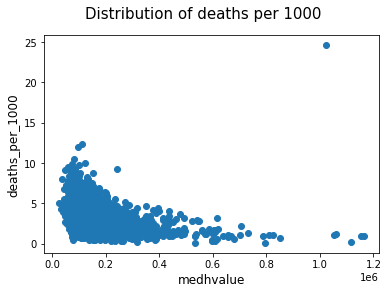

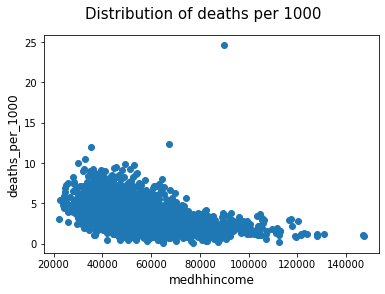

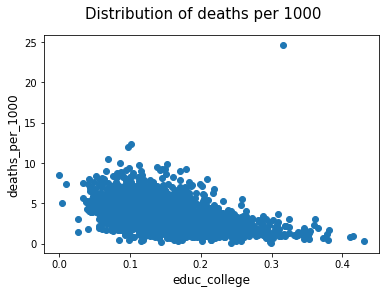

In [31]:
#quick look into the distribution of our data in relations to the highest -corr() factors
#Heavily right skewed graphs support these socioeconomic groups are of interest. 
import matplotlib.pyplot as plt
for v in ls:
    t = "Distribution of deaths per 1000 "
    corr_val = str(round(df_top_n.to_dict()['deaths_per_1000'][v],3))
    plt.suptitle(t, fontsize=15)
    plt.xlabel(v, fontsize=12)
    plt.ylabel('deaths_per_1000', fontsize=12)
    plt.scatter(covid_cases[v],covid_cases['deaths_per_1000'])
    plt.show()

In [32]:
def county_geomap(feature,df=covid_cases,corr_points=3):

    import plotly.express as px
    import plotly
      
    dates = '<br>'+"Recorded Dates: "+str(df_cases['date'].min())[:10] +" through "+ str(df_cases['date'].max())[:10]
    total_deaths = '<br>'+"Total Deaths: "+str(sum(df['deaths']))
    avg_deaths_per_1000 = '<br>'+"Average deaths per 1000 : "+ str(round(sum(df['deaths_per_1000'])/len(covid_cases.fips.unique()),3))+'<br>'
    
    df_top_n = corr_n_top(covid_cases)
    ls = df_top_n.index.values.tolist()[:corr_points]
    dt = df_top_n.to_dict()[feature]
    
    corr = '<br>'"Highest Negative Corrilations"
    corrv0 = '<br>'+ls[0]+": "+ str(round(dt[ls[0]],3))
    corrv1 = '<br>'+ls[1]+": "+ str(round(dt[ls[1]],3))
    corrv2 = '<br>'+ls[2]+": "+ str(round(dt[ls[2]],3))

    
    hover_data = ["state","county","deaths_per_1000"] + ls 
    
    title_text = dates + avg_deaths_per_1000 +corr+ corrv0 +corrv1 +corrv2

    fig = px.choropleth(df, geojson=counties, locations='fips', color=feature,
                               color_continuous_scale="Cividis",
                               hover_data=hover_data,
                               range_color=(df[feature].min(), int(sum(df['deaths_per_1000'])/len(covid_cases.fips.unique())*2)),
                               scope="usa",
                               height=900
                        )
    fig.update_layout(
        
        title_text=title_text,
        margin={"r":0,"t":0,"l":0,"b":0},
        annotations = [dict(
        x=0.5,
        y=0.02,
        xref='paper',
        yref='paper',
        text='Sources: <br> <a href="https://github.com/nytimes/covid-19-data/raw/master/us-counties.csv">\
            The New York Times COVID-19 Repository</a> <br> <a href="https://www.census.gov/programs-surveys/acs">\
             Census Bureau American Community Survey </a>',
        showarrow = False
    )]
    
    )
    
    #plotly.offline.plot(fig, filename='name.html')
    fig.write_html("geomap.html")
    
    fig.show()

In [33]:
county_geomap('deaths_per_1000',df)

In [34]:
# Exploring missing data

In [35]:
print("States of dropped counties: ",non_reporting_counties['state'].unique())

States of dropped counties:  ['Alaska' 'California' 'Colorado' 'Hawaii' 'Nebraska' 'North Dakota'
 'Texas' 'Utah']


In [36]:
print("Dropped counties: ",non_reporting_counties['county'].unique())

Dropped counties:  ['Skagway Municipality' 'Alpine' 'Hinsdale' 'Jackson' 'Kalawao' 'Hayes'
 'Keya Paha' 'Logan' 'Loup' 'Slope' 'King' 'Daggett' 'Rich' 'Wayne']


In [37]:
org_non_reporting_counties = non_reporting_counties
non_reporting_counties = non_reporting_counties.dropna(subset=ls)

In [38]:
print("Dropped data is roughly {0}% of the total population.".format(round(sum(org_non_reporting_counties['totpop'])/ sum(covid_cases['totpop']),2)*100))
print("We can use the existing data to estimate {0} misreported deaths (county-based).".format(round(sum(org_non_reporting_counties.cases) * (sum(covid_cases['deaths'])/sum(covid_cases['cases']))),0))

Dropped data is roughly 0.0% of the total population.
We can use the existing data to estimate 26 misreported deaths (county-based).


In [39]:
print("Of counties dropped that reported all 3 major catergories")
print("Average median household value:",round(sum(non_reporting_counties['medhvalue'])/len(non_reporting_counties),0))
print("Average median household income:",round(sum(non_reporting_counties['medhhincome'])/len(non_reporting_counties),0))
print("Average percentage of population with a bachlors degree:",str(round(sum(non_reporting_counties['educ_college'])/len(non_reporting_counties),2))+'%')

Of counties dropped that reported all 3 major catergories
Average median household value: 180208.0
Average median household income: 56601.0
Average percentage of population with a bachlors degree: 0.18%


## Analysis

We'll use this code to generate a dataframe to regress on the latest cumulative count of deaths at the county-level in order to discover some of the top predictors of COVID-19 mortality.

In [40]:
reg_df.shape

(3133, 68)

In [41]:
def get_reg_df_missing_summary():
    result_df = reg_df.isnull().sum() 
    result_df = result_df[result_df > 0].rename('count').to_frame()
    result_df['percent'] = result_df['count'] / len(reg_df)
    return result_df

get_reg_df_missing_summary()

,count,percent
medhhincome,1,0.000319
medhvalue,5,0.001596
poverty_black,175,0.055857


Lets take some time to look at the shape of our data.

In [42]:
import seaborn as sns

sns.pairplot(reg_df.iloc[:, -10:])

And finally some descriptive statistics

In [43]:
reg_df.describe().iloc[:, 40:].T

,count,mean,std,min,25%,50%,75%,max
occ_pro,3133.0,0.192611,0.046124,0.000000,0.163233,0.187848,0.217784,0.533287
occ_healthsupp,3133.0,0.036013,0.016195,0.000000,0.025873,0.034014,0.043803,0.177665
occ_protective,3133.0,0.023259,0.014874,0.000000,0.014233,0.020383,0.028231,0.141829
occ_food,3133.0,0.053187,0.019403,0.000000,0.041675,0.051797,0.062539,0.378824
occ_building,3133.0,0.040771,0.016193,0.000000,0.031201,0.038109,0.047337,0.226481
occ_personalcare,3133.0,0.023978,0.010404,0.000000,0.017855,0.023537,0.029113,0.109302
occ_sales,3133.0,0.090296,0.021750,0.000000,0.077117,0.091407,0.103595,0.220588
occ_officeadmin,3133.0,0.109493,0.021679,0.020906,0.097427,0.109645,0.120996,0.383529
occ_farming,3133.0,0.019632,0.025339,0.000000,0.004250,0.011001,0.024405,0.311688
occ_constextract,3133.0,0.104967,0.032319,0.000000,0.083762,0.101157,0.122048,0.281871


### We'll define our X variables and target variables here

In [44]:
X = reg_df.columns[4:-2].tolist()
label = 'deaths_per_1000'

## Train-test split for Regression Modeling

In [45]:
import sklearn.neighbors._base
sys.modules['sklearn.neighbors.base'] = sklearn.neighbors._base
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(reg_df[X], reg_df[label], test_size=.1, random_state=23)

In [46]:
from missingpy import MissForest

imputer = MissForest(n_estimators=200, max_depth=12, n_jobs=-1, random_state=9224)

imputer.fit(X_train)

X_train = pd.DataFrame(imputer.transform(X_train), columns=X)

Iteration: 0
Iteration: 1
Iteration: 2
Iteration: 3
Iteration: 4
Iteration: 5


In [47]:
# declare a dictionary to store regression results and attributes.
reg_results = {}

## LASSO

In [48]:
from sklearn.linear_model import Lasso
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

model = Pipeline([
    ('scale', StandardScaler()),
    ('lasso', Lasso(alpha=.30))
]).fit(X_train, y_train)

In [49]:
from sklearn.metrics import r2_score, mean_squared_error

y_hat = model.predict(imputer.transform(X_test.values))

r2 = r2_score(y_test, y_hat)
rmse = mean_squared_error(y_test, y_hat)

print('r2:', r2, 'rmse:', rmse)

reg_result_df = y_test.to_frame()
reg_result_df['y_hat'] = y_hat

Iteration: 0
Iteration: 1
Iteration: 2
r2: 0.3031415389203719 rmse: 1.783455912086191


/opt/anaconda3/envs/593/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but StandardScaler was fitted with feature names



In [50]:
df_feature = pd.DataFrame({'feature':X_train.columns, 
              'coef':model['lasso'].coef_, 
              'abs_coef':np.abs(model['lasso'].coef_)}
            ).sort_values('abs_coef', ascending=False)

df_feature[df_feature.abs_coef > 0].head()

,feature,coef,abs_coef
17,educ_lesshs,0.343625,0.343625
51,income_10k24k,0.158578,0.158578
1,medhhincome,-0.077778,0.077778
19,educ_college,-0.037650,0.037650
3,popdens,0.032527,0.032527


In [51]:
reg_results['lasso'] = dict(
    feature_importances=df_feature,
    reg_result=reg_result_df,
    r2=r2,
    rmse=rmse,
)

## Linear Regression

In [52]:
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

model = Pipeline([
    ('scale', StandardScaler()),
    ('lr', LinearRegression(n_jobs=-1))
]).fit(X_train, y_train)

In [53]:
from sklearn.metrics import r2_score, mean_squared_error

y_hat = model.predict(imputer.transform(X_test.values))

r2 = r2_score(y_test, y_hat)
rmse = mean_squared_error(y_test, y_hat)

print('r2:', r2, 'rmse:', rmse)

reg_result_df = y_test.to_frame()
reg_result_df['y_hat'] = y_hat

Iteration: 0
Iteration: 1
Iteration: 2
r2: 0.41549853135118875 rmse: 1.495902910140124


/opt/anaconda3/envs/593/lib/python3.7/site-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but StandardScaler was fitted with feature names



In [54]:
df_feature = pd.DataFrame({'feature':X_train.columns, 
              'coef':model['lr'].coef_, 
              'abs_coef':np.abs(model['lr'].coef_)}
            ).sort_values('abs_coef', ascending=False)

df_feature.head()

,feature,coef,abs_coef
17,educ_lesshs,317033.471751,317033.471751
24,ind_agmining,222294.086151,222294.086151
26,ind_manuf,220069.674248,220069.674248
19,educ_college,170237.287749,170237.287749
10,race_white,165124.539924,165124.539924


In [55]:
reg_results['lr'] = dict(
    feature_importances=df_feature,
    reg_result=reg_result_df,
    r2=r2,
    rmse=rmse,
)

## Random Forest Regression

In [56]:
from sklearn.ensemble import RandomForestRegressor
# from sklearn.model_selection import GridSearchCV

# param_grid = dict(
#     n_estimators=(200,),
#     criterion=['mse'],
#     max_depth=(None, 7, 12, 24),
#     max_features = ['auto', 'sqrt', 'log2'],
#     max_leaf_nodes = [None, 12, 24],
# )

# cv = GridSearchCV(estimator=RandomForestRegressor(n_jobs=-1, random_state=0), 
#                   param_grid=param_grid, cv=4, n_jobs=-1).fit(X_train, y_train)

# best_params_ = cv.best_params_

best_params_={'criterion': 'mse',
 'max_depth': 24,
 'max_features': 'auto',
 'max_leaf_nodes': None,
 'n_estimators': 200}

best_params_

{'criterion': 'mse',
 'max_depth': 24,
 'max_features': 'auto',
 'max_leaf_nodes': None,
 'n_estimators': 200}

In [57]:
from sklearn.metrics import r2_score, mean_squared_error

model = RandomForestRegressor(**best_params_, n_jobs=-1, random_state=0).fit(X_train.values, y_train)

y_hat = model.predict(imputer.transform(X_test))

r2 = r2_score(y_test, y_hat)
rmse = mean_squared_error(y_test, y_hat)

print('r2:', r2, 'rmse:', rmse)

reg_result_df = y_test.to_frame()
reg_result_df['y_hat'] = y_hat

Iteration: 0
Iteration: 1
Iteration: 2
r2: 0.42355363718422845 rmse: 1.47528763900148


In [58]:
df_feature = (pd.DataFrame({'feature':X_train.columns, 
              'coef':model.feature_importances_})
 .sort_values('coef',ascending=False))

df_feature.head()

,feature,coef
2,medhvalue,0.195893
17,educ_lesshs,0.129810
3,popdens,0.061801
1,medhhincome,0.037870
52,income_25k34k,0.016607


In [59]:
reg_results['random_forest'] = dict(
    feature_importances=df_feature,
    reg_result=reg_result_df,
    r2=r2,
    rmse=rmse,
)

## Regression Results

In [60]:
import altair as alt

modeling_method_long_name = dict(
    lasso='LASSO',
    lr='Linear Regression',
    random_forest='Random Forest Regressor',
)

def plot_reg_results():
    charts = []
    
    for reg_method in reg_results:
        feature_importance_df = reg_results[reg_method]['feature_importances']
        feature_importance_df = feature_importance_df.head()
        
        reg_result_df = reg_results[reg_method]['reg_result']
        r2 = reg_results[reg_method]['r2']
        rmse = reg_results[reg_method]['rmse']
        
        x_title = 'Coefficient' if reg_method in {'lasso', 'lr'} else 'Feature Importance'
        
        fi_chart = alt.Chart(feature_importance_df).mark_bar().encode(
            x=alt.X('coef:Q', title=x_title),
            y=alt.Y('feature:N', title=None, sort=feature_importance_df.feature.tolist()),
        ).properties(
            width=150, 
            height=150,
        )
        
        reg_result_df['hline'] = 0
        reg_result_df['2_std_plus'] = 2
        reg_result_df['2_std_minus'] = -2
        reg_result_df['residual'] = reg_result_df['deaths_per_1000'] - reg_result_df['y_hat']
        reg_result_df['standardized_residual'] = StandardScaler().fit_transform(reg_result_df['residual'].values.reshape(-1, 1))
        
        min_scale, max_scale = reg_result_df['standardized_residual'].min(), reg_result_df['standardized_residual'].max()-1
        
        qq_scale=alt.Scale(domain=(min_scale, max_scale))
        
        qq_chart = alt.Chart(reg_result_df).transform_quantile(
            'standardized_residual',
            step=0.01,
            as_ = ['p', 'v']
        ).transform_calculate(
            normal = 'quantileNormal(datum.p)'
        ).mark_point(opacity=.4).encode(
            y=alt.Y('v:Q', scale=qq_scale, title='Standardized Res. Quantile'),
            x=alt.X('normal:Q', scale=qq_scale, title='Theoretical Normal Distribution')
        )
        
        qq_line_df = pd.DataFrame({'x':[min_scale, max_scale], 'y':[min_scale, max_scale]})
        
        qq_line = alt.Chart(qq_line_df).mark_line(color='red', opacity=.3).encode(
            x=alt.X('x:Q'),
            y=alt.Y('y:Q'),
        )
        
        qq_chart = (qq_line + qq_chart).properties(
            width=150, 
            height=150,
        )
        
        res_base = alt.Chart(reg_result_df)
        
        res_chart = res_base.mark_circle(opacity=.4).encode(
            x=alt.X('y_hat:Q', title='Deaths Per 1000 Pop. (predicted)'),
            y=alt.Y('standardized_residual:Q', title='Standardized Residual')
        )
        
        hline_chart = res_base.mark_line(color='blue', opacity=.5).encode(
            x=alt.X('y_hat:Q'),
            y=alt.Y('hline:Q'),
        )
        
        std_plus_chart = res_base.mark_line(color='red', opacity=.25).encode(
            x=alt.X('y_hat:Q'),
            y=alt.Y('2_std_plus:Q'),
        )
        
        std_minus_chart = res_base.mark_line(color='red', opacity=.25).encode(
            x=alt.X('y_hat:Q'),
            y=alt.Y('2_std_minus:Q'),
        )
        
        res_chart = (res_chart + hline_chart + std_plus_chart + std_minus_chart).properties(
            width=150, 
            height=150,
        )
        
        chart = (res_chart & qq_chart & fi_chart).properties(
            title=alt.TitleParams(f'{modeling_method_long_name[reg_method]}',
                                 subtitle=[f'R^2: {r2:.2f}',
                                           f'RMSE: {rmse:.2f}'],
                                 anchor='middle',
                                 dx=50)
        )
        
        charts.append(chart)
    
    return alt.hconcat(*charts)
    
# plot_reg_results()

## PCA Biplot

We see a couple of very interesting themes emerging here (education, income, and wealth). Lets analyze these on a PCA bi-plot to get a sense of the linear relationships between these variables.

In [61]:
X = ['educ_lesshs', 'educ_college', 'medhvalue', 'income_10k24k', 'medhhincome', 'income_25k34k', 'deaths_per_1000']

In [62]:
from sklearn.decomposition import PCA
from missingpy import MissForest
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

imputer = MissForest(max_depth=12, n_jobs=-1, random_state=9224)

pre_processor = Pipeline([
    ('impute', imputer),
    ('scale', StandardScaler()),
])

pca_data = pre_processor.fit_transform(reg_df[X])

pca = PCA(n_components=2, random_state=0).fit(pca_data)

pc_scores = pca.transform(pca_data)

pca.explained_variance_ratio_.cumsum()

Iteration: 0
Iteration: 1
Iteration: 2
Iteration: 3


array([0.65373602, 0.75807419])

In [63]:
import plotly.express as px
# import plotly.offline as pyo
# import plotly.graph_objs as go
# # Set notebook mode to work in offline
# pyo.init_notebook_mode()

def plot_pca_biplot():
    loadings = pca.components_.T
    
    fig = px.scatter(loadings, 
                     x=0, y=1, 
                     color_discrete_sequence=["red"], 
                     opacity=.4, 
                     width=1200, height=800,
                    labels={
                     '0': f"PC1 - Explained Variance Ratio {pca.explained_variance_ratio_[0]:.0%}",
                     '1': f"PC2 - Explained Variance Ratio {pca.explained_variance_ratio_[1]:.0%}",
                     },
                    title="<b>Census ACS and NYT Covid-19 PCA Biplot</b>")

    for i, feature in enumerate(X):
        fig.add_shape(
            type='line',
            x0=0, y0=0,
            x1=loadings[i, 0],
            y1=loadings[i, 1],
            opacity=.1
        )
        
        kwargs = dict(
            x=loadings[i, 0],
            y=loadings[i, 1],
            ax=0, ay=-2,
            xanchor="center",
            yanchor="bottom",
            text=feature,
            opacity=.7,
            font=dict(color='darkslategrey')
        )
        
        if feature == label:
            kwargs['opacity'] = 1
            kwargs['showarrow'] = True
            kwargs['arrowsize'] = 1 
            kwargs['arrowwidth'] = 2
            kwargs['arrowhead'] = 1
            kwargs['ay'] = 35
            kwargs['ax'] = -30
            kwargs['font'] = dict(size=12, family='Arial', color='blue')
            kwargs['standoff'] = 5
            kwargs['text'] = f"<b>{feature.replace('_', ' ').title()} Pop.</b>"
        
        
        fig.add_annotation(**kwargs)
        
    fig.update_layout(title_x=0.5, title_y=.925)
    fig.show()
    
plot_pca_biplot()